In [2]:
## load the libraries 
%matplotlib inline
import sys
import warnings
import os
import glob
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
import cv2
from sklearn.model_selection import train_test_split

from keras.layers import *
from keras.callbacks import EarlyStopping
from keras.utils import to_categorical
from keras.models import Model, Sequential
from keras.metrics import *
from keras.optimizers import Adam, RMSprop
from scipy.stats import norm
from keras.preprocessing import image
from keras import datasets

from keras import backend as K
import random
import matplotlib.pyplot as plt
from skimage import exposure
plt.gray()

os.environ["CUDA_VISIBLE_DEVICES"]="1" #model will be trained on GPU 1

Using TensorFlow backend.


<Figure size 432x288 with 0 Axes>

In [3]:
def load_image(path):
    x_size = 64
    y_size = 64
    image_list = np.zeros((len(path), x_size, y_size,1))
    for i, fig in enumerate(path):
        img = image.load_img(fig, color_mode='grayscale', target_size=(x_size, y_size))
        img = image.img_to_array(img).astype('float32')
        img = img / 255.0
        '''
        max_i = img.max()
        min_i = img.min()

        img = (img - min_i) / (max_i - min_i)
        '''
        
        image_list[i] = img#exposure.equalize_adapthist(img[:,:,0])
        
    return image_list

In [4]:
"""
train_img = glob.glob("/home/webvalley/Documents/plaque-image-preprocessing/Data/Patches/Plaque/Aug/cal/*.png")
train_img += glob.glob("/home/webvalley/Documents/plaque-image-preprocessing/Data/Patches/Plaque/Aug/fibrous/*.png")
train_img += random.sample(glob.glob("/home/webvalley/Documents/plaque-image-preprocessing/Data/Patches/NoPlaque/*.png"), 3790)
"""
train_img = glob.glob("train/*.png")

test_img = glob.glob("test/*.png")


random.shuffle(train_img)
random.shuffle(test_img)

x_train = load_image(train_img)
x_test = load_image(test_img) 

In [5]:
for i, img in enumerate(x_train):
    max_i = img.max()
    min_i = img.min()
    if max_i == min_i:
        img = np.zeros((64,64,1))
    else:
        img = (img - min_i) / (max_i - min_i)
        img = exposure.equalize_adapthist(img[:,:,0])
    
    x_train[i] = img.reshape(64,64,1)

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/home/webvalley/anaconda3/envs/plaque-img/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3296, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-5-936e6cffc83d>", line 8, in <module>
    img = exposure.equalize_adapthist(img[:,:,0])
  File "/home/webvalley/anaconda3/envs/plaque-img/lib/python3.7/site-packages/skimage/color/adapt_rgb.py", line 40, in image_filter_adapted
    return image_filter(image, *args, **kwargs)
  File "/home/webvalley/anaconda3/envs/plaque-img/lib/python3.7/site-packages/skimage/exposure/_adapthist.py", line 86, in equalize_adapthist
    image = _clahe(image, kernel_size, clip_limit * nbins, nbins)
  File "/home/webvalley/anaconda3/envs/plaque-img/lib/python3.7/site-packages/skimage/exposure/_adapthist.py", line 147, in _clahe
    hist = np.append(hist, np.zeros(nbins - hist.size, dtype=int))
  File "/home/webvalley/anaconda3/envs/plaque-img/lib/python3.7/site-p

KeyboardInterrupt: 

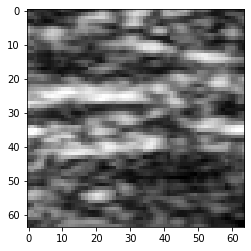

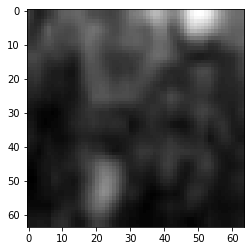

In [8]:
plt.imshow(x_train[0].reshape(64,64))
plt.show()
plt.imshow(img.reshape(64,64))
plt.show()

In [ ]:
"""
imgs = glob.glob("/home/webvalley/Documents/plaque-image-preprocessing/AutoEncoder/test/*.png")
print(imgs[len(imgs)-1])


for _ in range(200):
    r = random.randint(0, len(imgs)-1)
    name = imgs[r].split("/")[-1]
    while not "noplaque" in name:
        r = random.randint(0, len(imgs))
        name = imgs[r].split("/")[-1]
    
    print('mv "' + imgs[r] + '" /home/webvalley/Documents/plaque-image-preprocessing/AutoEncoder/train')

    os.system('mv "' + imgs[r] + '" /home/webvalley/Documents/plaque-image-preprocessing/AutoEncoder/train')


for im in glob.glob("/home/webvalley/Documents/plaque-image-preprocessing/Data/Patches/Plaque/Aug/cal/*.png"):
    #print(im)
    os.system(f"cp {im} train")
"""

In [9]:
y_test = []

for img in test_img:
    if "Calcific" in img:
        y_test.append(0)
    elif "Fibrous" in img:
        y_test.append(1)
    elif "noplaque" in img:
        y_test.append(2)

In [10]:
batch_size = 128
epochs = 20
inChannel = 1
x, y = 64, 64
input_img = Input(shape = (x, y, inChannel))
print(input_img.shape)

(?, 64, 64, 1)


In [11]:
img_rows, img_cols, img_chns = x, y, 1
# number of convolutional filters to use
NB_FILTERS = 16
# convolution kernel size
KERNEL_SIZE = (3, 3)


LATENT_DIM = 128
INTERMEDIATE_DIM = 256
NB_EPOCHS = 100

conv_1 = Conv2D(1, kernel_size=(2, 2), padding='same', activation='relu')(input_img)
conv_2 = Conv2D(NB_FILTERS, kernel_size=(2, 2),
                       padding='same', activation='relu',
                       strides=(2, 2))(conv_1)
conv_3 = Conv2D(NB_FILTERS, KERNEL_SIZE,
                       padding='same', activation='relu',
                       strides=(1, 1))(conv_2)
conv_4 = Conv2D(NB_FILTERS, KERNEL_SIZE,
                       padding='same', activation='relu',
                       strides=(1, 1))(conv_3)
flat = Reshape((-1,))(conv_4)
hidden = Dense(INTERMEDIATE_DIM, activation='relu')(flat)

z = Dense(LATENT_DIM)(hidden)

decoder_hid = Dense(INTERMEDIATE_DIM, activation='relu')(z)
decoder_upsample = Dense(NB_FILTERS * img_rows//2 * img_rows//2, activation='relu')(decoder_hid)

decoder_reshape = Reshape((img_rows//2, img_rows//2, NB_FILTERS))(decoder_upsample)
decoder_deconv_1 = Conv2DTranspose(NB_FILTERS, KERNEL_SIZE,
                                   padding='same',
                                   strides=(1, 1),
                                   activation='relu')(decoder_reshape)
decoder_deconv_2 = Conv2DTranspose(NB_FILTERS, KERNEL_SIZE,
                                   padding='same',
                                   strides=(1, 1),
                                   activation='relu')(decoder_deconv_1)

decoder_deconv_3_upsamp = Conv2DTranspose(NB_FILTERS, kernel_size=(2, 2),
                                          padding='valid',
                                          strides=(2, 2),
                                          activation='relu')(decoder_deconv_2)
decoder_mean_squash = Conv2D(img_chns, kernel_size=(1, 1),
                                    padding='valid',
                                    activation='sigmoid')(decoder_deconv_3_upsamp)


Instructions for updating:
Colocations handled automatically by placer.


Instructions for updating:
Colocations handled automatically by placer.


In [194]:
"""FUNZIONANTE
# Encoder
encoded = Conv2D(2,(3,3),
           activation='relu',
           padding='same')(input_img)
encoded = Conv2D(2,(3,3),
           activation='relu',
           padding='same')(encoded)
encoded = MaxPooling2D((2,2))(encoded) 
encoded = Conv2D(4,(3,3),
           activation='relu',
           padding='same')(encoded)
encoded = Conv2D(4,(3,3),
           activation='relu',
           padding='same')(encoded)
encoded = MaxPooling2D((2,2))(encoded) 
encoded = Flatten()(encoded)
encoded = Dense(64, activation='relu')(encoded)
encoded = Dense(4)(encoded)

# Decoder
decoded = Dense(64, activation='relu')(encoded)
decoded = Dense(1024, activation='relu')(decoded)
decoded = Reshape((7,7,4))(decoded)
decoded = UpSampling2D((2, 2))(decoded)
decoded = Conv2D(4, (3, 3),
           activation='relu',
           padding='same')(decoded)
decoded = Conv2D(2, (3, 3),
           activation='relu',
           padding='same')(decoded)
decoded = UpSampling2D((2, 2))(decoded) 
decoded = Conv2D(2, (3, 3),
           activation='relu',
           padding='same')(decoded)
decoded = Conv2D(1, (3, 3),
           padding='same')(decoded)
"""

"FUNZIONANTE\n# Encoder\nencoded = Conv2D(2,(3,3),\n           activation='relu',\n           padding='same')(input_img)\nencoded = Conv2D(2,(3,3),\n           activation='relu',\n           padding='same')(encoded)\nencoded = MaxPooling2D((2,2))(encoded) \nencoded = Conv2D(4,(3,3),\n           activation='relu',\n           padding='same')(encoded)\nencoded = Conv2D(4,(3,3),\n           activation='relu',\n           padding='same')(encoded)\nencoded = MaxPooling2D((2,2))(encoded) \nencoded = Flatten()(encoded)\nencoded = Dense(64, activation='relu')(encoded)\nencoded = Dense(4)(encoded)\n\n# Decoder\ndecoded = Dense(64, activation='relu')(encoded)\ndecoded = Dense(1024, activation='relu')(decoded)\ndecoded = Reshape((7,7,4))(decoded)\ndecoded = UpSampling2D((2, 2))(decoded)\ndecoded = Conv2D(4, (3, 3),\n           activation='relu',\n           padding='same')(decoded)\ndecoded = Conv2D(2, (3, 3),\n           activation='relu',\n           padding='same')(decoded)\ndecoded = UpSampli

In [195]:
"""
# encoding architecture
encoded = Conv2D(64, (3, 3), activation='relu', padding='same')(input_img)
print(encoded.shape)
encoded = MaxPool2D( (2, 2), padding='same')(encoded)
encoded = Conv2D(32, (3, 3), activation='relu', padding='same')(encoded)
encoded = MaxPool2D( (2, 2), padding='same')(encoded)
encoded = Conv2D(16, (3, 3), activation='relu', padding='same')(encoded)
encoded = MaxPool2D((2, 2), padding='same')(encoded)
encoded = Flatten()(encoded)
encoded = Dense(128)(encoded)
encoded = Dense(2)(encoded)
"""

"\n# encoding architecture\nencoded = Conv2D(64, (3, 3), activation='relu', padding='same')(input_img)\nprint(encoded.shape)\nencoded = MaxPool2D( (2, 2), padding='same')(encoded)\nencoded = Conv2D(32, (3, 3), activation='relu', padding='same')(encoded)\nencoded = MaxPool2D( (2, 2), padding='same')(encoded)\nencoded = Conv2D(16, (3, 3), activation='relu', padding='same')(encoded)\nencoded = MaxPool2D((2, 2), padding='same')(encoded)\nencoded = Flatten()(encoded)\nencoded = Dense(128)(encoded)\nencoded = Dense(2)(encoded)\n"

In [196]:
"""
# decoding architecture
decoded = Dense(256)(encoded)
decoded = Reshape((4, 4, 16))(decoded)
decoded = UpSampling2D((2, 2))(decoded)
decoded = Conv2D(16, (3, 3), activation='relu', padding='same')(decoded)
decoded = UpSampling2D((2, 2))(decoded)
decoded = Conv2D(32, (3, 3), activation='relu', padding='same')(decoded)
decoded = UpSampling2D((2, 2))(decoded)
decoded = Conv2D(64, (3, 3), activation='relu', padding='same')(decoded)
decoded = UpSampling2D((2, 2))(decoded)
decoded = Conv2D(1, (3, 3), padding='same')(decoded)
"""

"\n# decoding architecture\ndecoded = Dense(256)(encoded)\ndecoded = Reshape((4, 4, 16))(decoded)\ndecoded = UpSampling2D((2, 2))(decoded)\ndecoded = Conv2D(16, (3, 3), activation='relu', padding='same')(decoded)\ndecoded = UpSampling2D((2, 2))(decoded)\ndecoded = Conv2D(32, (3, 3), activation='relu', padding='same')(decoded)\ndecoded = UpSampling2D((2, 2))(decoded)\ndecoded = Conv2D(64, (3, 3), activation='relu', padding='same')(decoded)\ndecoded = UpSampling2D((2, 2))(decoded)\ndecoded = Conv2D(1, (3, 3), padding='same')(decoded)\n"

In [12]:

smooth = 1

def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def dice_coef_loss(y_true, y_pred):
    return 1-dice_coef(y_true, y_pred)


In [13]:
# compile the model

model = Model(input_img, decoder_mean_squash)
model.compile(optimizer=Adam(lr=0.0001), loss='mse')#dice_coef, metrics=[dice_coef_loss])
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 64, 64, 1)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 64, 64, 1)         5         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 32, 32, 16)        80        
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 32, 32, 16)        2320      
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 32, 32, 16)        2320      
_________________________________________________________________
reshape_1 (Reshape)          (None, 16384)             0         
_________________________________________________________________
dense_1 (Dense)              (None, 256)               4194560   
__________

In [17]:
#early_stopping = EarlyStopping(monitor='val_loss', min_delta=0, patience=10, verbose=5, mode='auto')
history = model.fit(x_train, x_train, epochs=100, batch_size=batch_size, validation_data=(x_test, x_test))#, callbacks=[early_stopping])

Train on 6981 samples, validate on 599 samples
Epoch 1/100
6981/6981 [==============================] - 31s 4ms/step - loss: 0.0607 - val_loss: 0.0304
Epoch 2/100
6981/6981 [==============================] - 30s 4ms/step - loss: 0.0536 - val_loss: 0.0177
Epoch 3/100
6981/6981 [==============================] - 30s 4ms/step - loss: 0.0517 - val_loss: 0.0112
Epoch 4/100
6981/6981 [==============================] - 30s 4ms/step - loss: 0.0505 - val_loss: 0.0086
Epoch 5/100
6981/6981 [==============================] - 30s 4ms/step - loss: 0.0489 - val_loss: 0.0068
Epoch 6/100
6981/6981 [==============================] - 31s 4ms/step - loss: 0.0480 - val_loss: 0.0059
Epoch 7/100
6981/6981 [==============================] - 30s 4ms/step - loss: 0.0472 - val_loss: 0.0055
Epoch 8/100
6981/6981 [==============================] - 31s 4ms/step - loss: 0.0464 - val_loss: 0.0050
Epoch 9/100
6981/6981 [==============================] - 31s 4ms/step - loss: 0.0456 - val_loss: 0.0046
Epoch 10/100
6981

6981/6981 [==============================] - 41s 6ms/step - loss: 0.0251 - val_loss: 0.0021
Epoch 79/100
6981/6981 [==============================] - 42s 6ms/step - loss: 0.0250 - val_loss: 0.0021
Epoch 80/100
6981/6981 [==============================] - 42s 6ms/step - loss: 0.0250 - val_loss: 0.0021
Epoch 81/100
6981/6981 [==============================] - 47s 7ms/step - loss: 0.0249 - val_loss: 0.0021
Epoch 82/100
6981/6981 [==============================] - 47s 7ms/step - loss: 0.0248 - val_loss: 0.0020
Epoch 83/100
6981/6981 [==============================] - 48s 7ms/step - loss: 0.0247 - val_loss: 0.0021
Epoch 84/100
6981/6981 [==============================] - 54s 8ms/step - loss: 0.0247 - val_loss: 0.0020
Epoch 85/100
6981/6981 [==============================] - 56s 8ms/step - loss: 0.0246 - val_loss: 0.0021
Epoch 86/100
6981/6981 [==============================] - 55s 8ms/step - loss: 0.0246 - val_loss: 0.0021
Epoch 87/100
6981/6981 [==============================] - 54s 8ms/st

In [14]:
from keras.models import load_model 
model.load_weights('autoencoder_model.h5')

In [15]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

NameError: name 'history' is not defined

In [20]:
# compile the model

# adam = optimizers.Adam(lr=0.01)

encoder = Model(input_img, z)
encoder.compile(optimizer=Adam(lr=0.0001), loss='mse')#dice_coef, metrics=[dice_coef_loss])

In [21]:
img = x_train[0]

In [22]:
img.shape

(64, 64, 1)

In [23]:
encoded_imgs = encoder.predict(x_test)
decoded_imgs = model.predict(x_test)

In [24]:
encoded_imgs.shape
#print(encoded_imgs[0].shape)

(599, 128)

In [25]:
encoded_imgs[0].shape

(128,)

In [26]:
encoded_imgs[0]

array([-2.649889  , -4.4359813 ,  2.7489064 ,  5.947263  , -1.5880967 ,
       -1.9373684 ,  1.0453069 , -2.5735989 ,  2.2458782 , -3.0477324 ,
       -7.708545  , -3.6223288 ,  2.431594  , -0.33803162, -3.7301278 ,
        0.4824832 ,  4.265978  ,  1.6818194 ,  1.9265316 ,  3.17777   ,
        4.1505885 , -0.3297912 ,  6.9501185 , -2.1528635 , -8.915075  ,
        0.5787423 ,  1.276628  , -0.12337559,  0.04323136, -2.2775474 ,
        1.0794854 ,  3.3669808 , -2.7958872 , -3.0784295 ,  5.54008   ,
        2.068426  ,  3.5048966 , -1.1317579 , -0.3210181 , -3.5985496 ,
        1.6153852 , -5.5539646 , -3.4113085 ,  4.8684874 ,  8.573305  ,
       -3.1288557 , -3.258025  , -1.6500266 , -2.23386   ,  2.0550447 ,
        1.2123407 , -1.5919079 , -2.5562577 , -5.4351716 ,  0.6462763 ,
        4.102823  ,  4.8340745 , -1.2784435 , -1.9594121 ,  2.5419421 ,
       -1.8278687 ,  2.5515516 ,  2.1881645 ,  3.525693  ,  7.2648683 ,
       -0.89150035,  0.11895086, -2.3106625 ,  6.7048373 ,  0.05

In [27]:
label_conv = {
    0: 'Calcific',
    1: 'Fibrous',
    2: 'NoPlaque'
}

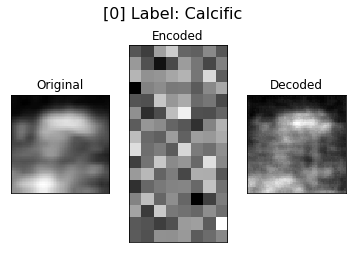

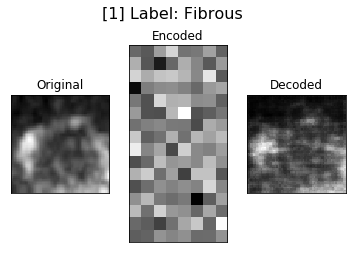

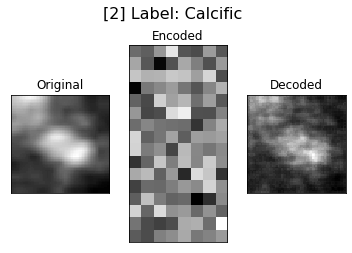

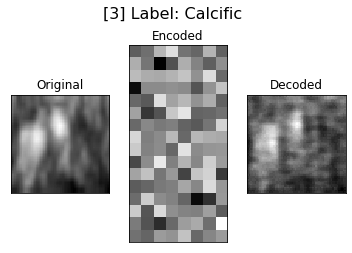

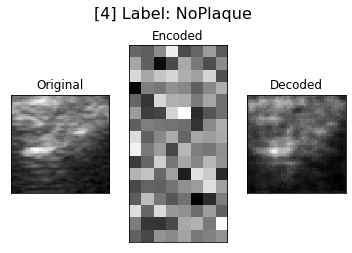

...

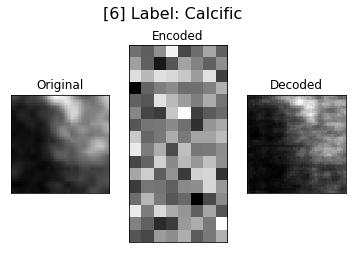

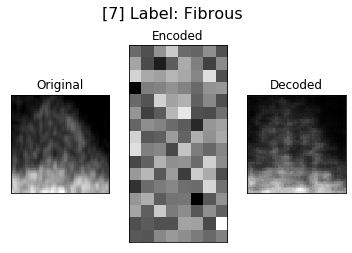

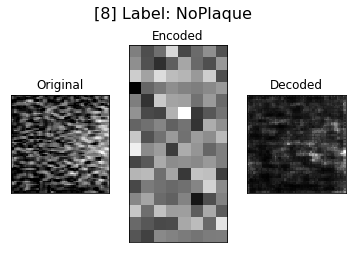

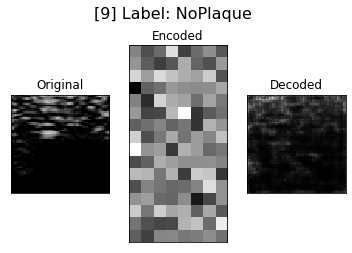

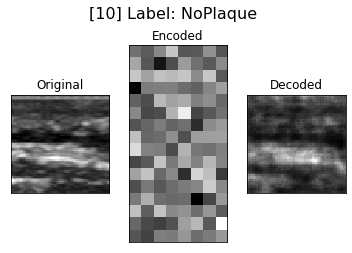

In [28]:

for i in range(11):
    fig, ((ax1, ax2, ax3)) = plt.subplots(1, 3)
    
    fig.suptitle(f"[{i}] Label: " + label_conv[y_test[i]], fontsize=16)
    
    ax1.imshow(x_test[i].reshape((64, 64)))
    ax1.set_title("Original")
    
    ax1.get_xaxis().set_visible(False)
    ax1.get_yaxis().set_visible(False)
    
    ax2.imshow(encoded_imgs[i].reshape((16, 8)))
    ax2.set_title("Encoded")
    
    ax2.get_xaxis().set_visible(False)
    ax2.get_yaxis().set_visible(False)
    
    ax3.imshow(decoded_imgs[i].reshape((64, 64)))
    ax3.set_title("Decoded")
    
    ax3.get_xaxis().set_visible(False)
    ax3.get_yaxis().set_visible(False)
    
    plt.show()

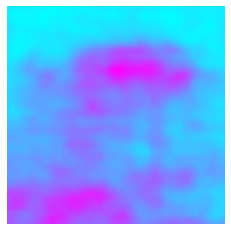

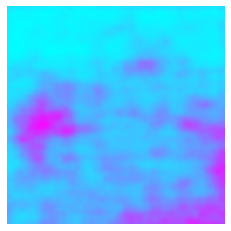

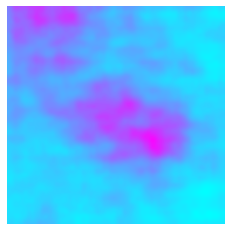

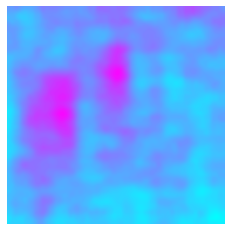

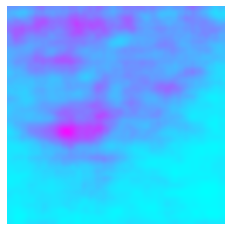

...

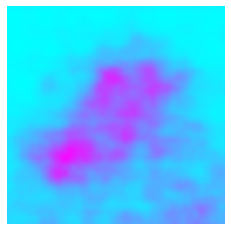

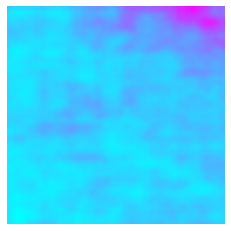

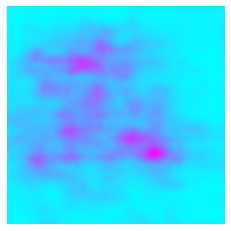

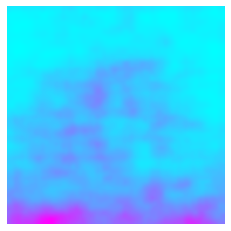

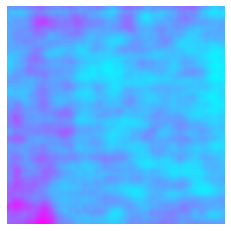

In [41]:
for i in range(599):
    img_name = train_img[i].split('/')[-1].replace('.png', '')
    plt.axis('off')
    plt.imshow(decoded_imgs[i].reshape((64, 64)), interpolation = 'bicubic', cmap = 'cool')
    plt.savefig(f'dataset/Filters/hsv_updated/{img_name}_{interpolation_method}.png')
    interpolation_method = 'bicubic'
    plt.show()

In [43]:
import pandas as pd 
data = [[0,0,0,"test"] for _ in range (250)]
for index, fn in enumerate(os.listdir('dataset/Filters/hsv_updated/')[:250]):
    img = plt.imread(os.path.join('dataset/Filters/hsv_updated/', fn))
    for i in img:
        red_content = 0 
        blue_content = 0 
        green_content = 0
        for j in i: 
            r = j[0]
            b = j[1]
            g = j[2]
            if (b!= g and g != r and r != b):
                if (b > r and b > g):
                    blue_content += 1 

                if (r > b and r > g):
                    red_content += 1 

                if (g > r and g > b):
                    green_content += 1  
                    
                data[index] = [red_content, green_content, blue_content, label_conv[y_test[index]]]
            
    percent_complete = index/250*100
    print("percent complete: ", percent_complete)
    print("data values: ", data[index])
            
df = pd.DataFrame(data, columns = ['Red', 'Green', 'Blue','Name']) 
df

percent complete:  0.0
data values:  [0, 218, 0, 'Calcific']
percent complete:  0.4
data values:  [0, 218, 0, 'Fibrous']
percent complete:  0.8
data values:  [0, 218, 0, 'Calcific']
percent complete:  1.2
data values:  [0, 218, 0, 'Calcific']
percent complete:  1.6
data values:  [0, 218, 0, 'NoPlaque']
percent complete:  2.0
data values:  [0, 218, 0, 'NoPlaque']
percent complete:  2.4
data values:  [0, 218, 0, 'Calcific']
percent complete:  2.8000000000000003
data values:  [0, 218, 0, 'Fibrous']
percent complete:  3.2
data values:  [0, 218, 0, 'NoPlaque']
percent complete:  3.5999999999999996
data values:  [0, 218, 0, 'NoPlaque']
percent complete:  4.0
data values:  [0, 218, 0, 'NoPlaque']
percent complete:  4.3999999999999995
data values:  [0, 218, 0, 'NoPlaque']
percent complete:  4.8
data values:  [0, 218, 0, 'NoPlaque']
percent complete:  5.2
data values:  [0, 218, 0, 'Calcific']
percent complete:  5.6000000000000005
data values:  [0, 218, 0, 'Calcific']
percent complete:  6.0
data

percent complete:  50.4
data values:  [0, 218, 0, 'Calcific']
percent complete:  50.8
data values:  [0, 218, 0, 'Calcific']
percent complete:  51.2
data values:  [0, 218, 0, 'NoPlaque']
percent complete:  51.6
data values:  [0, 218, 0, 'Fibrous']
percent complete:  52.0
data values:  [0, 218, 0, 'Calcific']
percent complete:  52.400000000000006
data values:  [0, 218, 0, 'Fibrous']
percent complete:  52.800000000000004
data values:  [0, 218, 0, 'NoPlaque']
percent complete:  53.2
data values:  [0, 218, 0, 'NoPlaque']
percent complete:  53.6
data values:  [0, 218, 0, 'Calcific']
percent complete:  54.0
data values:  [0, 218, 0, 'Calcific']
percent complete:  54.400000000000006
data values:  [0, 218, 0, 'NoPlaque']
percent complete:  54.800000000000004
data values:  [0, 218, 0, 'Calcific']
percent complete:  55.2
data values:  [0, 218, 0, 'Fibrous']
percent complete:  55.60000000000001
data values:  [0, 218, 0, 'NoPlaque']
percent complete:  56.00000000000001
data values:  [0, 218, 0, 'Ca

,Red,Green,Blue,Name
0,0,218,0,Calcific
1,0,218,0,Fibrous
2,0,218,0,Calcific
3,0,218,0,Calcific
4,0,218,0,NoPlaque
5,0,218,0,NoPlaque
6,0,218,0,Calcific
7,0,218,0,Fibrous
8,0,218,0,NoPlaque
9,0,218,0,NoPlaque


In [35]:
from sklearn.preprocessing import StandardScaler
features = ['Red', 'Green', 'Blue']
# Separating out the features
x = df.loc[:, features].values
# Separating out the target
y = df.loc[:,['Name']].values
# Standardizing the features
x = StandardScaler().fit_transform(x)

In [36]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents, columns = ['principal component 1', 'principal component 2'])

In [37]:
pca.explained_variance_ratio_

array([0.59634437, 0.4035629 ])

In [38]:
finalDf = pd.concat([principalDf, df[['Name']]], axis = 1)

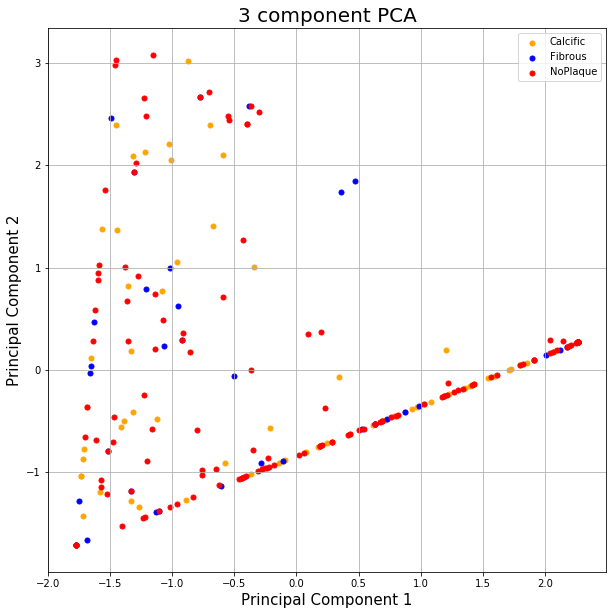

In [39]:
fig = plt.figure(figsize = (10,10))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('3 component PCA', fontsize = 20)
targets = ['Calcific', 'Fibrous', 'NoPlaque']
colors = ['orange', 'blue', 'red']
for target, color in zip(targets,colors):
    indicesToKeep = finalDf['Name'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal component 1'], finalDf.loc[indicesToKeep, 'principal component 2'],c = color , s = 25)
ax.legend(targets)
ax.grid()

In [209]:
from sklearn.metrics.pairwise import cosine_similarity

cos_sim = cosine_similarity(encoded_imgs[2].reshape(1,-1), encoded_imgs[1].reshape(1,-1))

In [210]:
cos_sim

array([[0.856961]], dtype=float32)

In [211]:
np.sum(np.subtract(encoded_imgs[0], encoded_imgs[5]))

10.547576

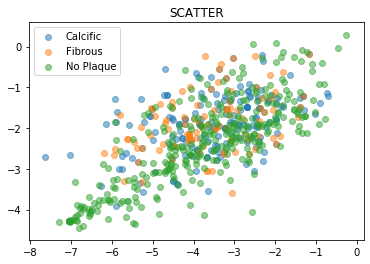

In [212]:
#encoded_imgs[np.array(y_test) == 1]
plt.title("SCATTER")
plt.scatter(encoded_imgs[np.array(y_test) == 0][:, 0], encoded_imgs[np.array(y_test) == 0][:, 1], label='Calcific', alpha=0.5)
plt.scatter(encoded_imgs[np.array(y_test) == 1][:, 0], encoded_imgs[np.array(y_test) == 1][:, 1], label='Fibrous', alpha=0.5)
plt.scatter(encoded_imgs[np.array(y_test) == 2][:, 0], encoded_imgs[np.array(y_test) == 2][:, 1], label='No Plaque', alpha=0.5)
plt.legend();

In [213]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)
proj = pca.fit_transform(encoded_imgs)


In [214]:
len(proj)

599

In [215]:
len(pca.components_)

3

In [216]:
pca.explained_variance_

array([107.686424,  23.888382,  11.164042], dtype=float32)

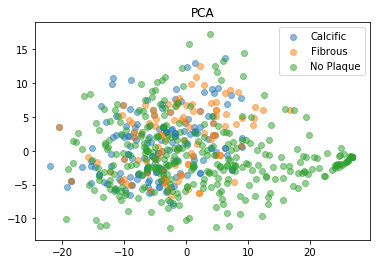

In [217]:
plt.title("PCA")
plt.scatter(proj[np.array(y_test) == 0][:, 0], proj[np.array(y_test) == 0][:, 1], label='Calcific', alpha=0.5)
plt.scatter(proj[np.array(y_test) == 1][:, 0], proj[np.array(y_test) == 1][:, 1], label='Fibrous', alpha=0.5)
plt.scatter(proj[np.array(y_test) == 2][:, 0], proj[np.array(y_test) == 2][:, 1], label='No Plaque', alpha=0.5)
plt.legend();

In [218]:
import umap


standard_embedding = umap.UMAP(random_state=42).fit_transform(encoded_imgs)
"""
plt.scatter(standard_embedding[:, 0], standard_embedding[:, 1], c=y_test, cmap='Spectral', alpha=0.5)
plt.colorbar();
"""

"\nplt.scatter(standard_embedding[:, 0], standard_embedding[:, 1], c=y_test, cmap='Spectral', alpha=0.5)\nplt.colorbar();\n"

In [219]:
standard_embedding

array([[ -5.099073 ,   5.0577903],
       [ -6.477247 ,   5.032584 ],
       [ -9.096176 ,   1.9331567],
       ...,
       [ -7.4406443,   1.645895 ],
       [-10.283782 ,   2.2732882],
       [ -6.915839 ,   3.147963 ]], dtype=float32)

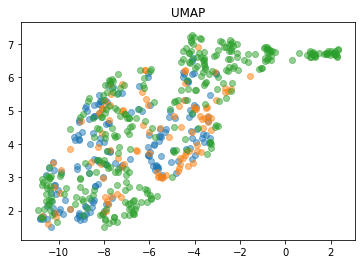

In [220]:
plt.title("UMAP")
plt.scatter(standard_embedding[np.array(y_test) == 0][:, 0], standard_embedding[np.array(y_test) == 0][:, 1], alpha=0.5)
plt.scatter(standard_embedding[np.array(y_test) == 1][:, 0], standard_embedding[np.array(y_test) == 1][:, 1], alpha=0.5)
plt.scatter(standard_embedding[np.array(y_test) == 2][:, 0], standard_embedding[np.array(y_test) == 2][:, 1], alpha=0.5);

In [221]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=3,perplexity=40).fit_transform(encoded_imgs)

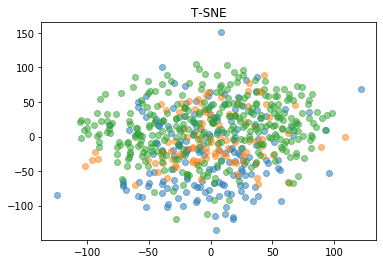

In [223]:
plt.title("T-SNE")
plt.scatter(tsne[np.array(y_test) == 0][:, 0], tsne[np.array(y_test) == 0][:, 1], alpha=0.5)
plt.scatter(tsne[np.array(y_test) == 1][:, 0], tsne[np.array(y_test) == 1][:, 1], alpha=0.5)
plt.scatter(tsne[np.array(y_test) == 2][:, 0], tsne[np.array(y_test) == 2][:, 1], alpha=0.5);